In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd drive/Shareddrives/CIS519_Spring2023/

/content/drive/Shareddrives/CIS519_Spring2023


In [ ]:
#! unzip labeled_data.zip -d labeled_data

In [3]:
import json
import os
import random
import argparse

import pandas as pd
import numpy as np
import math
import time
import matplotlib.pyplot as plt
import json
import codecs
import cv2

In [4]:
f = open('labeled_data/labeled_input/metadata/metadata/iwildcam2022_train_annotations.json')
annotations = json.load(f)
annotations_df = pd.DataFrame.from_records(annotations['images'])

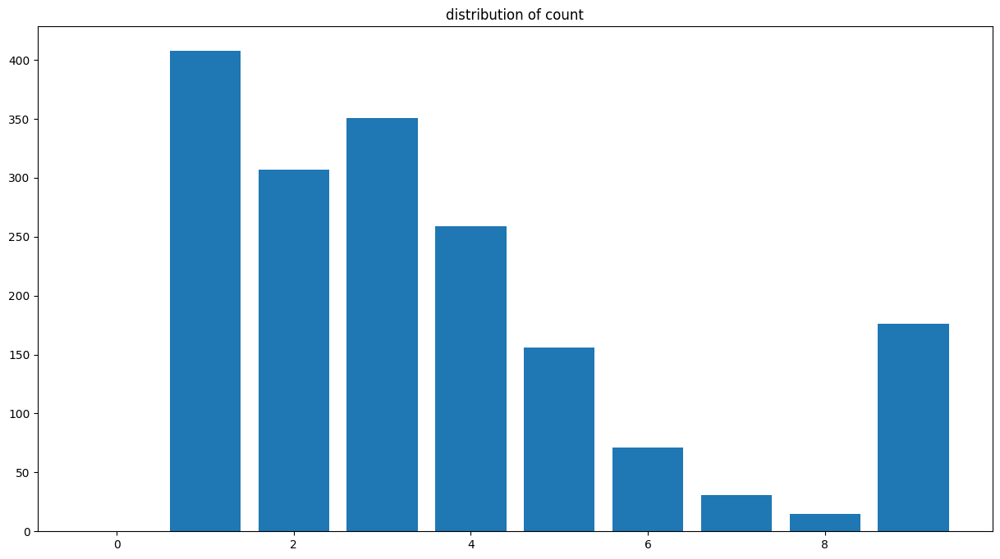

In [5]:
df_count = pd.read_csv("labeled_data/labeled_input/metadata/metadata/train_sequence_counts.csv")
count = []
for i in range(max(df_count["count"])):
    count.append(len(df_count[df_count["count"]==i]))
f = plt.figure(figsize=(15,8))
f = plt.title("distribution of count")
f = plt.bar([x for x in range(len(count))],count)

In [6]:
with codecs.open("labeled_data/labeled_input/metadata/metadata/iwildcam2022_train_annotations.json", 'r',
                 encoding='utf-8', errors='ignore') as f:
    train_meta = json.load(f)
df_seq = pd.DataFrame(train_meta['images'])
df_seq = df_seq.drop(["seq_num_frames","datetime","width","width","height","id","sub_location","location"],axis=1)
df_seq.head()

,seq_id,file_name,seq_frame_num
0,30048d32-7d42-11eb-8fb5-0242ac1c0002,8b02698a-21bc-11ea-a13a-137349068a90.jpg,0
1,30048d32-7d42-11eb-8fb5-0242ac1c0002,8e5b81de-21bc-11ea-a13a-137349068a90.jpg,1
2,30048d32-7d42-11eb-8fb5-0242ac1c0002,8c6be0e4-21bc-11ea-a13a-137349068a90.jpg,2
3,30048d32-7d42-11eb-8fb5-0242ac1c0002,8fdf7998-21bc-11ea-a13a-137349068a90.jpg,3
4,30048d32-7d42-11eb-8fb5-0242ac1c0002,96093c50-21bc-11ea-a13a-137349068a90.jpg,4


Get all the images in a Sequence

In [7]:
seq_id = "3021a08e-7d42-11eb-8fb5-0242ac1c0002"
df_c = df_count[df_count["seq_id"]==seq_id]
print("Images in sequence: ",len(df_seq[df_seq["seq_id"]==seq_id]))
df = df_seq[df_seq["seq_id"]==seq_id]
for i in range(len(df)):
    img = cv2.imread("labeled_data/labeled_input/train/train/"+df.iloc[i]["file_name"])
    if not img is None:
      plt.imshow(img)
      plt.show()
    else:
      print("missing image")

Output hidden; open in https://colab.research.google.com to view.

Setup Baseline: Return Simple Max of MegaDetector outputs for a sequence. We can use this to evaluate our model against until we are ready to begin kaggle submissions


In [8]:
with codecs.open("labeled_data/labeled_input/metadata/metadata/iwildcam2022_mdv4_detections.json", 'r',
                 encoding='utf-8', errors='ignore') as f:
    md_meta = json.load(f)

In [9]:
seq_counts = pd.read_csv('labeled_data/labeled_input/metadata/metadata/train_sequence_counts.csv')  
seq_counts.head()

,seq_id,count
0,95dae922-21bc-11ea-a13a-137349068a90,9
1,2fff6c8a-7d42-11eb-8fb5-0242ac1c0002,9
2,300cc650-7d42-11eb-8fb5-0242ac1c0002,9
3,30125958-7d42-11eb-8fb5-0242ac1c0002,9
4,301d2d24-7d42-11eb-8fb5-0242ac1c0002,9


In [10]:
def count_useful_detections(row, threshold):
  return len([x for x in row if (x['category']=='1' and x['conf']>threshold)])

In [11]:
conf_thresh = 0.75

#: based on the various metadata structures, get a useful training frame from Mega Detector
df_seq = df_seq.where(df_seq['seq_id'].isin(list(seq_counts['seq_id']))).dropna()
df_seq["file_name"]= 'train/' + df_seq['file_name'].astype(str)
df_mega = pd.DataFrame(md_meta['images'])
df_mega_full_train = df_mega.where(df_mega['file'].isin(list(df_seq['file_name']))).dropna()
vfunc = np.vectorize(count_useful_detections)
df_mega_full_train['detections'] = vfunc(df_mega_full_train['detections'], conf_thresh)
_df_seq = df_seq.rename({'file_name': 'file'}, axis=1).drop('seq_frame_num',axis=1)
df_mega_full_train = pd.merge(df_mega_full_train, _df_seq, on='file', how='inner')
df_mega_full_train

,file,max_detection_conf,detections,seq_id
0,train/8dae8cae-21bc-11ea-a13a-137349068a90.jpg,0.974,1,301cceec-7d42-11eb-8fb5-0242ac1c0002
1,train/922368fe-21bc-11ea-a13a-137349068a90.jpg,0.999,3,300a44e8-7d42-11eb-8fb5-0242ac1c0002
2,train/994d9d8e-21bc-11ea-a13a-137349068a90.jpg,0.754,1,302b1902-7d42-11eb-8fb5-0242ac1c0002
3,train/9936f6e2-21bc-11ea-a13a-137349068a90.jpg,0.998,1,9936f868-21bc-11ea-a13a-137349068a90
4,train/91d35990-21bc-11ea-a13a-137349068a90.jpg,0.955,1,300a242c-7d42-11eb-8fb5-0242ac1c0002
...,...,...,...,...
13185,train/9067a962-21bc-11ea-a13a-137349068a90.jpg,0.997,1,30138dfa-7d42-11eb-8fb5-0242ac1c0002
13186,train/8bc84b32-21bc-11ea-a13a-137349068a90.jpg,0.999,4,30270e34-7d42-11eb-8fb5-0242ac1c0002
13187,train/8a5f5790-21bc-11ea-a13a-137349068a90.jpg,0.997,1,979882d8-21bc-11ea-a13a-137349068a90
13188,train/8f113920-21bc-11ea-a13a-137349068a90.jpg,0.999,3,3012584a-7d42-11eb-8fb5-0242ac1c0002


By this point, `seq_counts` holds our labels (y),  `df_mega_full_train` holds our input references (X)





---
## MegaDetector Simple Max Baseline 


In [ ]:
mega_baseline = pd.DataFrame(columns =['y_true','y_pred'])
mega_baseline = pd.DataFrame({'y_true': pd.Series(dtype='int'),
                   'y_pred': pd.Series(dtype='int')})
for index, row in seq_counts.iterrows():
  y_true = row['count']
  y_pred = max(df_mega_full_train[df_mega_full_train["seq_id"]==row['seq_id']]['detections'])
  mega_baseline = pd.concat([mega_baseline,pd.DataFrame({'y_true': [y_true],'y_pred': [y_pred]})], ignore_index=True)

In [ ]:
mega_baseline_avg = pd.DataFrame(columns =['y_true','y_pred'])
mega_baseline_avg = pd.DataFrame({'y_true': pd.Series(dtype='int'),
                   'y_pred': pd.Series(dtype='int')})
for index, row in seq_counts.iterrows():
  y_true = row['count']
  y_pred = df_mega_full_train[df_mega_full_train["seq_id"]==row['seq_id']]['detections'].mean()
  mega_baseline_avg = pd.concat([mega_baseline_avg,pd.DataFrame({'y_true': [y_true],'y_pred': [y_pred]})], ignore_index=True)

array([[<Axes: title={'center': 'y_true'}>,
        <Axes: title={'center': 'y_pred'}>]], dtype=object)

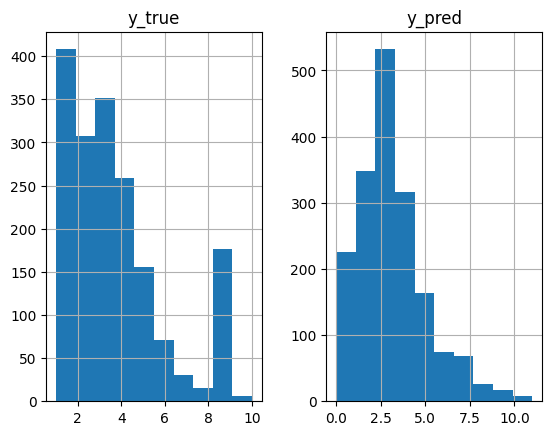

In [ ]:
mega_baseline.hist()

array([[<Axes: title={'center': 'y_true'}>,
        <Axes: title={'center': 'y_pred'}>]], dtype=object)

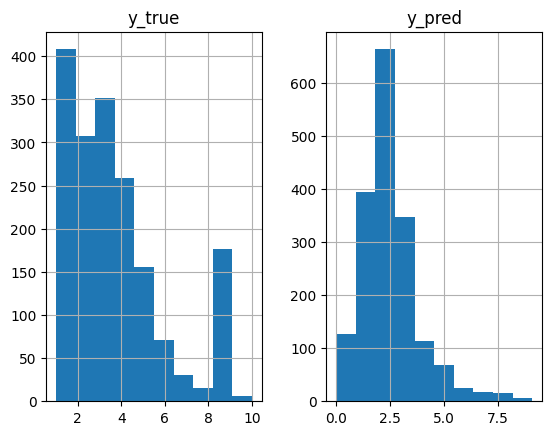

In [ ]:
mega_baseline_avg.hist()

In [ ]:
from sklearn.metrics import mean_absolute_error
#: You can play around with the confidence threshold and it will give different things
#: These aren't quite the same as the kaggle scores, since we are using a totally different distribution
#: There are a lot more zeros in the actual distribution I think
print("MegaDetector take max MAE:",mean_absolute_error(mega_baseline['y_true'], mega_baseline['y_pred']))
print("MegaDetector take mean MAE:",mean_absolute_error(mega_baseline_avg['y_true'], mega_baseline_avg['y_pred']))
print("Always predict one MAE:",mean_absolute_error(np.ones(1780), mega_baseline['y_pred']))
print("Always predict zero MAE:",mean_absolute_error(np.zeros(1780), mega_baseline['y_pred'])) 

MegaDetector take max MAE: 0.8926966292134831
MegaDetector take mean MAE: 1.261067415730337
Always predict one MAE: 2.3814606741573034
Always predict zero MAE: 3.3297752808988763


Benchmark to beat for now: 0.877 MAE. Comp to this instead of kaggle board until we are ready to work with the test set



---



In [ ]:
# simplify annotation frame
df_label = pd.read_csv("labeled_data/labeled_input/metadata/metadata/train_sequence_counts.csv")

f = open('labeled_data/labeled_input/metadata/metadata/iwildcam2022_train_annotations.json')
with codecs.open("labeled_data/labeled_input/metadata/metadata/iwildcam2022_train_annotations.json", 'r',
                 encoding='utf-8', errors='ignore') as f:
    train_meta = json.load(f)
df_seq = pd.DataFrame(train_meta['images'])
df_seq = df_seq.drop(["seq_num_frames","datetime","width","width","height","id","sub_location","location"],axis=1)
df_seq['count_per_image'] = [0]*len(df_seq)
df_seq = df_seq.where(df_seq['seq_id'].isin(list(df_label['seq_id']))).dropna()
df_seq = df_seq.reset_index(drop=True)
df_seq.head()

,seq_id,file_name,seq_frame_num,count_per_image
0,5c8f4d8a-7ed0-11eb-b7d6-0242ac1c0002,8ab0ba0e-21bc-11ea-a13a-137349068a90.jpg,0.0,0.0
1,5c8f4d8a-7ed0-11eb-b7d6-0242ac1c0002,9159fece-21bc-11ea-a13a-137349068a90.jpg,1.0,0.0
2,5c8f4d8a-7ed0-11eb-b7d6-0242ac1c0002,9807316a-21bc-11ea-a13a-137349068a90.jpg,2.0,0.0
3,5c8f4d8a-7ed0-11eb-b7d6-0242ac1c0002,98ebf30e-21bc-11ea-a13a-137349068a90.jpg,3.0,0.0
4,5c8f4d8a-7ed0-11eb-b7d6-0242ac1c0002,989a0b20-21bc-11ea-a13a-137349068a90.jpg,4.0,0.0


In [ ]:
from tqdm import tqdm
for i in tqdm(range(len(df_label))):
  seq_id = df_label.iloc[i]['seq_id']
  count = df_label.iloc[i]['count']
  df_seq['count_per_image'] = np.where(df_seq['seq_id']==seq_id, count, df_seq['count_per_image'])

100%|██████████| 1780/1780 [00:03<00:00, 493.04it/s]


In [ ]:
# get rid of files that doesn't exist in image file
new_df_seq = df_seq
for i in tqdm(range(len(df_seq))):
  img_name = os.path.join("labeled_data/labeled_input/train/train", df_seq.iloc[i]['file_name'])
  if not os.path.isfile(img_name):
    new_df_seq = new_df_seq.drop(i, inplace=False)

new_df_seq = new_df_seq.reset_index(drop=True)

100%|██████████| 13190/13190 [00:07<00:00, 1724.79it/s]


<Axes: >

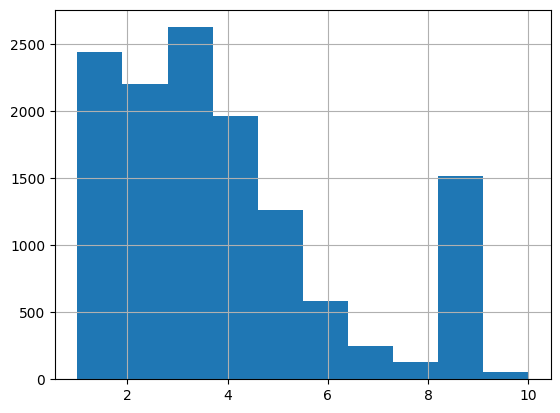

In [ ]:
new_df_seq['count_per_image'].hist()

In [ ]:
empty_images = df_mega_full_train[df_mega_full_train['detections']==0][abs(df_mega_full_train['max_detection_conf'])<0.5]
empty_images

<ipython-input-62-7d3d8fc9123d>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  empty_images = df_mega_full_train[df_mega_full_train['detections']==0][abs(df_mega_full_train['max_detection_conf'])<0.5]


,file,max_detection_conf,detections,seq_id
62,train/8973233e-21bc-11ea-a13a-137349068a90.jpg,0.478,0,3002e838-7d42-11eb-8fb5-0242ac1c0002
70,train/97e1a3fa-21bc-11ea-a13a-137349068a90.jpg,0.000,0,97e1a576-21bc-11ea-a13a-137349068a90
74,train/8c54e45c-21bc-11ea-a13a-137349068a90.jpg,0.000,0,300b1594-7d42-11eb-8fb5-0242ac1c0002
89,train/91c91142-21bc-11ea-a13a-137349068a90.jpg,0.000,0,3014893a-7d42-11eb-8fb5-0242ac1c0002
98,train/87103eb0-21bc-11ea-a13a-137349068a90.jpg,0.435,0,302335fc-7d42-11eb-8fb5-0242ac1c0002
...,...,...,...,...
12973,train/93fa05b6-21bc-11ea-a13a-137349068a90.jpg,0.157,0,3000fa46-7d42-11eb-8fb5-0242ac1c0002
13027,train/90de784e-21bc-11ea-a13a-137349068a90.jpg,0.263,0,97e1a576-21bc-11ea-a13a-137349068a90
13034,train/95977412-21bc-11ea-a13a-137349068a90.jpg,0.000,0,9811938a-21bc-11ea-a13a-137349068a90
13052,train/979bf0e4-21bc-11ea-a13a-137349068a90.jpg,0.234,0,3002e784-7d42-11eb-8fb5-0242ac1c0002


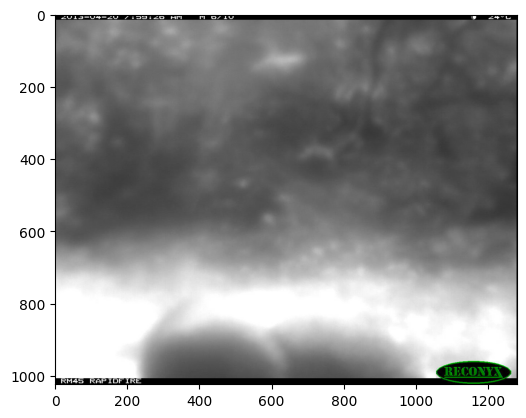

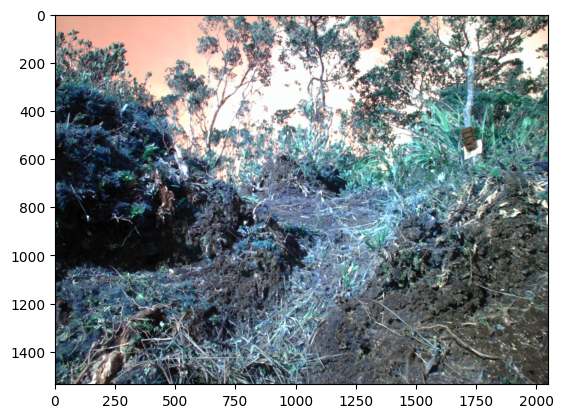

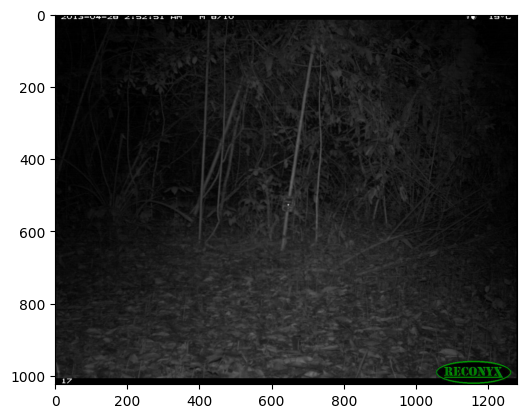

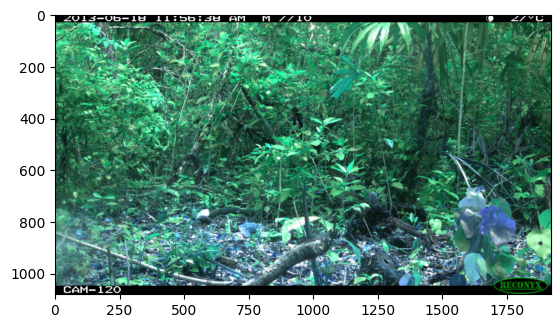

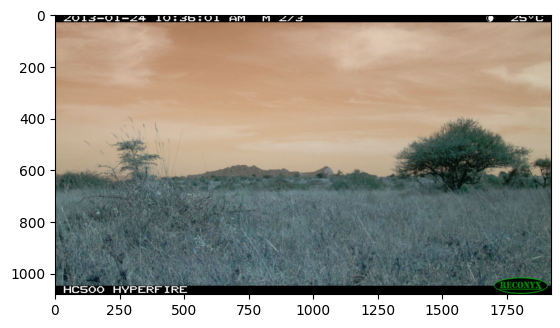

...

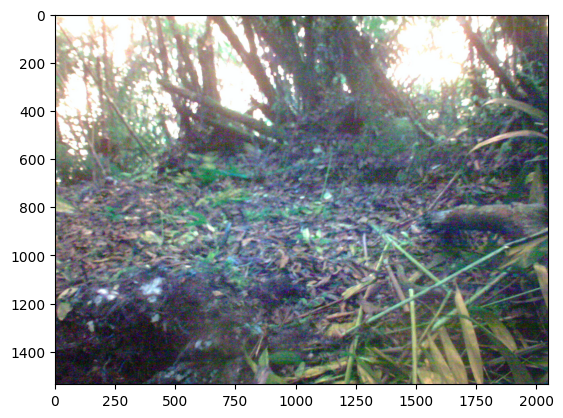

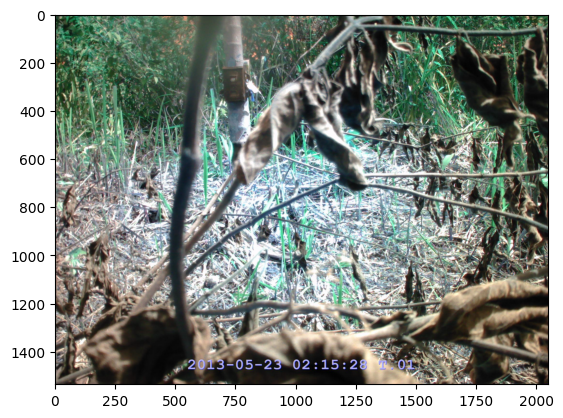

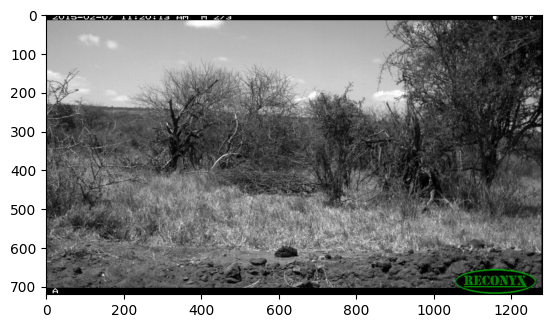

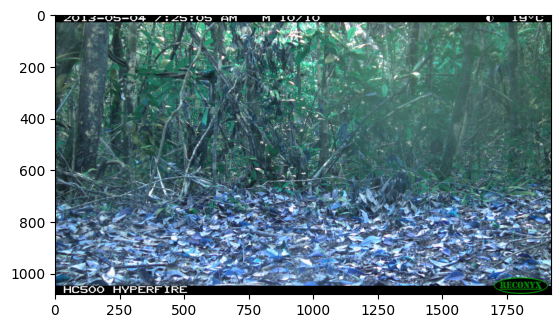

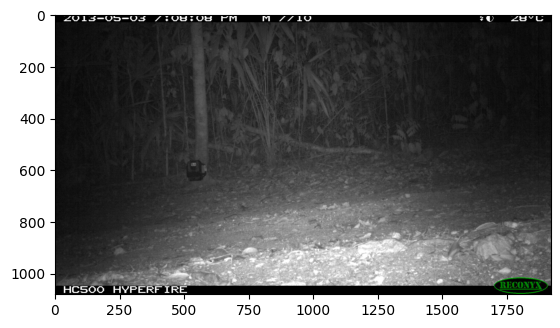

KeyboardInterrupt: ignored

In [ ]:
for i in range(len(empty_images)):
    img = cv2.imread("labeled_data/labeled_input/train/"+empty_images.iloc[i]["file"])
    if not img is None:
      plt.imshow(img)
      plt.show()